In [2]:
import numpy as np
from imblearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder,MinMaxScaler,StandardScaler,RobustScaler,QuantileTransformer
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer


####Importing model selection and validation metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, f1_score, recall_score, accuracy_score, average_precision_score ,auc,roc_auc_score


#### Importing models
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import VotingClassifier , StackingClassifier


In [3]:
import pandas as pd
data=pd.read_excel('URLData_ZDInterviewProject.xlsx')

In [4]:
data


,URL,Google Rank,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words
0,www.zocdoc.com/REMOVED,13.3,2.925108,8.155650,5.492020,0.411771,0.027854
1,www.zocdoc.com/REMOVED,15.4,5.017281,9.216409,6.675830,0.398341,0.299199
2,www.zocdoc.com/REMOVED,12.8,3.589217,5.160371,4.845896,0.525228,0.099290
3,www.zocdoc.com/REMOVED,8.6,5.026451,7.585764,4.317448,0.312497,0.230270
4,www.zocdoc.com/REMOVED,9.4,3.506564,4.271116,6.056736,0.347528,0.029108
...,...,...,...,...,...,...,...
4995,www.zocdoc.com/REMOVED,14.6,3.604645,9.048714,5.494865,0.410219,0.005616
4996,www.zocdoc.com/REMOVED,7.9,4.231499,4.478854,4.143249,0.517284,0.048231
4997,www.zocdoc.com/REMOVED,14.2,2.651688,10.261650,4.371300,0.436143,0.199530
4998,www.zocdoc.com/REMOVED,15.0,3.982989,10.583220,5.191706,0.447086,0.179928


In [4]:
def conditions(x) :
    if x<=10:
        return 'Desired Rank'
    # elif (x>10 and x<=15):
    #     return 'Average Rank'  
    else:
        return 'Bad'



data1=data


data1['category']=data1['Google Rank'].apply(conditions)

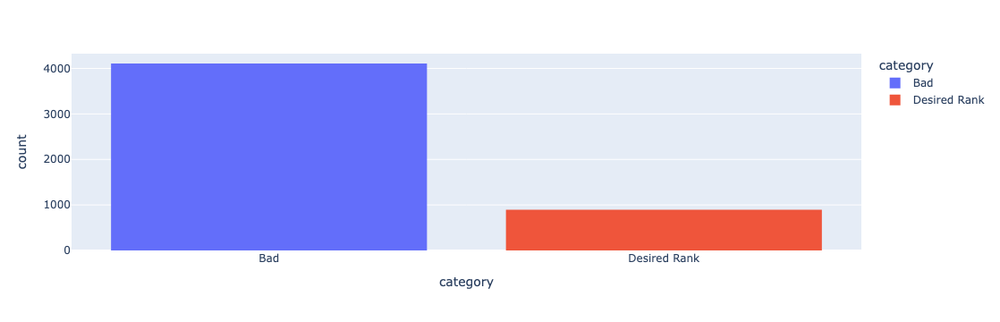

In [5]:
import plotly.express as px
px.histogram(data1, x='category',color='category')

In [6]:
numeric_columns=data.select_dtypes(include=['float','int'])

In [7]:
data.isnull().sum()

URL                           0
Google Rank                   0
# Reviews                     0
Number of Preview Profiles    0
Distance                      0
% Cross Listed Results        0
% Templated Words             0
category                      0
dtype: int64

In [11]:
data1

,URL,Google Rank,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words,category
0,www.zocdoc.com/REMOVED,13.3,2.925108,8.155650,5.492020,0.411771,0.027854,Bad
1,www.zocdoc.com/REMOVED,15.4,5.017281,9.216409,6.675830,0.398341,0.299199,Bad
2,www.zocdoc.com/REMOVED,12.8,3.589217,5.160371,4.845896,0.525228,0.099290,Bad
3,www.zocdoc.com/REMOVED,8.6,5.026451,7.585764,4.317448,0.312497,0.230270,Desired Rank
4,www.zocdoc.com/REMOVED,9.4,3.506564,4.271116,6.056736,0.347528,0.029108,Desired Rank
...,...,...,...,...,...,...,...,...
4995,www.zocdoc.com/REMOVED,14.6,3.604645,9.048714,5.494865,0.410219,0.005616,Bad
4996,www.zocdoc.com/REMOVED,7.9,4.231499,4.478854,4.143249,0.517284,0.048231,Desired Rank
4997,www.zocdoc.com/REMOVED,14.2,2.651688,10.261650,4.371300,0.436143,0.199530,Bad
4998,www.zocdoc.com/REMOVED,15.0,3.982989,10.583220,5.191706,0.447086,0.179928,Bad


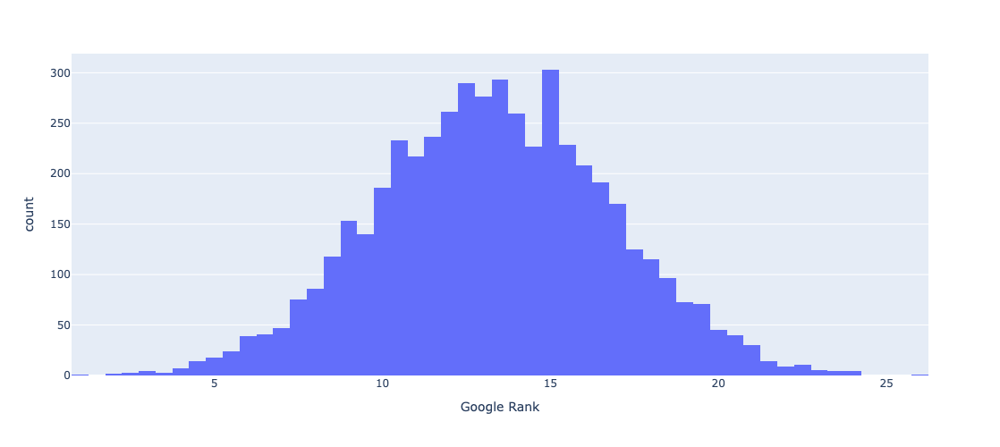

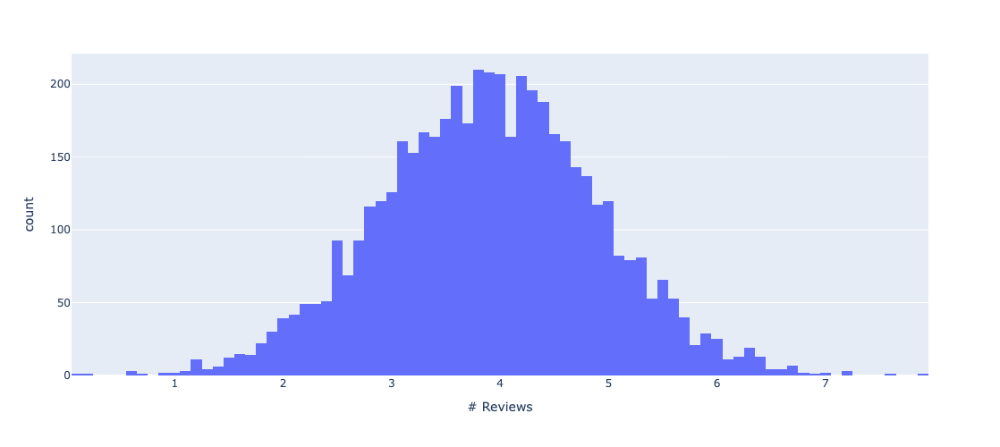

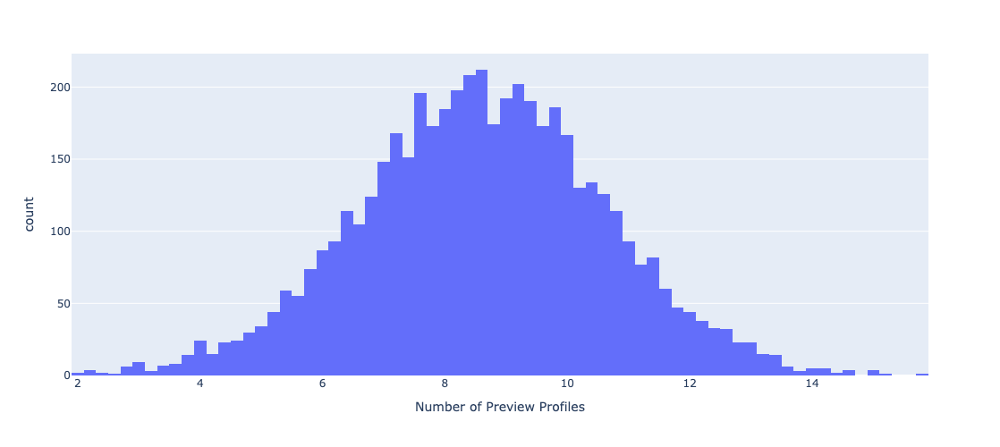

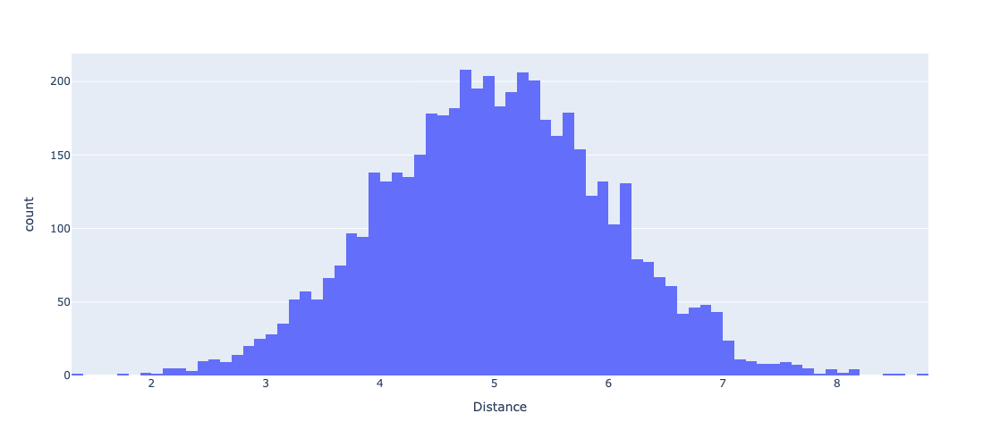

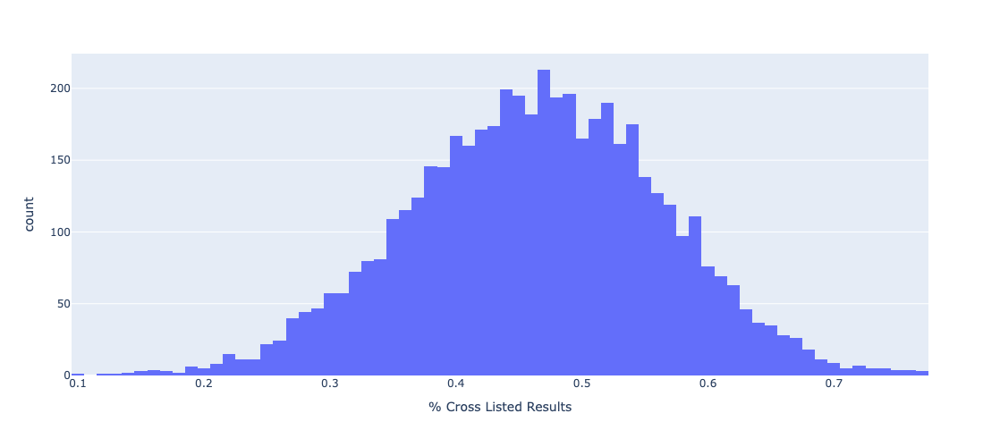

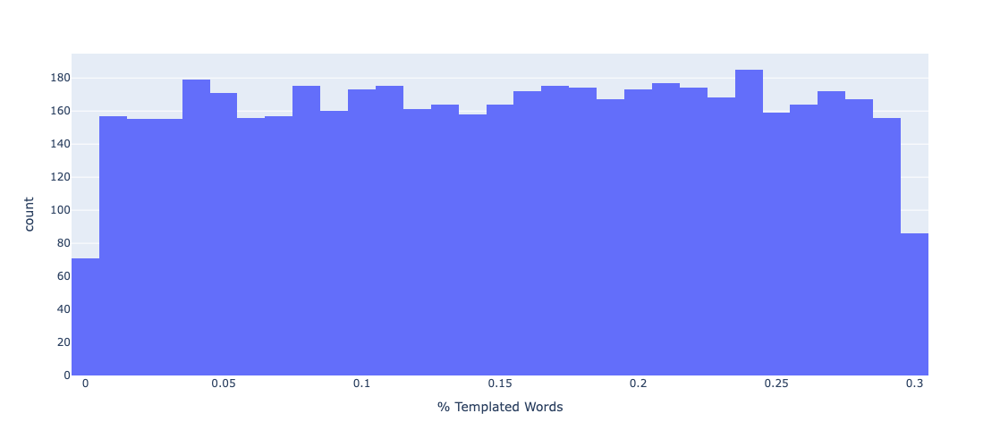

In [8]:
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.express as px

for i in numeric_columns.columns:
    
    pyo.init_notebook_mode(connected=True)
    
    fig=px.histogram(data,x=i)
    fig.update_layout(
        width=1000, height=500
    
        
     
        
    )
    
    fig.show()

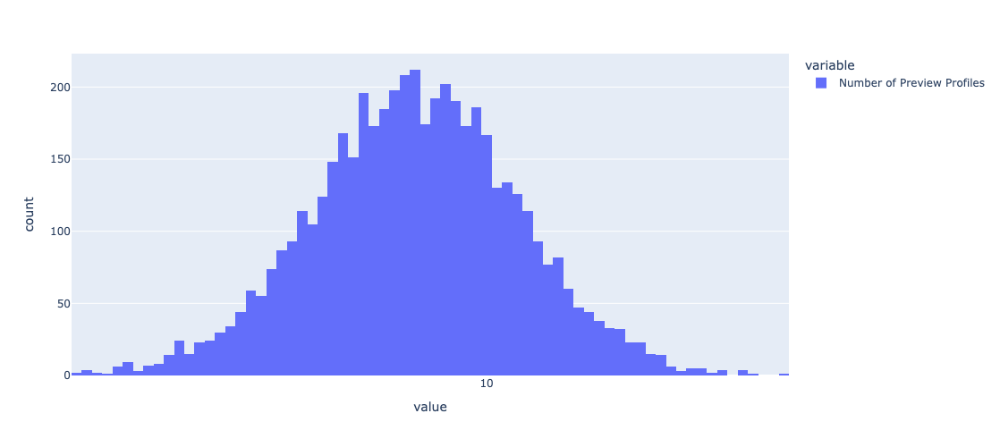

In [9]:
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.express as px


pyo.init_notebook_mode(connected=True)

fig=px.histogram(data['Number of Preview Profiles'])
fig.update_layout(
    width=1000, height=500,


   xaxis = dict(
        tickmode = 'array',
        tick0 =0,
        tickvals = [0, 10, 20, 50, 100, 150,200,250,350,500,100000],
    )


 
    
)

fig.show()

In [10]:
from ydata_profiling import ProfileReport
profile = ProfileReport(data, title="Profiling Report")

In [11]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [209]:
# data['Number of Preview Profiles']=round(data['Number of Preview Profiles'])
# data

,URL,Google Rank,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words,category,Range,Range_PP
0,www.zocdoc.com/REMOVED,13.3,2.925108,8.0,5.492020,0.411771,0.027854,Bad,8-10,8-10
1,www.zocdoc.com/REMOVED,15.4,5.017281,9.0,6.675830,0.398341,0.299199,Bad,8-10,8-10
2,www.zocdoc.com/REMOVED,12.8,3.589217,5.0,4.845896,0.525228,0.099290,Bad,0-6,0-6
3,www.zocdoc.com/REMOVED,8.6,5.026451,8.0,4.317448,0.312497,0.230270,Desired Rank,6-8,6-8
4,www.zocdoc.com/REMOVED,9.4,3.506564,4.0,6.056736,0.347528,0.029108,Desired Rank,0-6,0-6
...,...,...,...,...,...,...,...,...,...,...
4995,www.zocdoc.com/REMOVED,14.6,3.604645,9.0,5.494865,0.410219,0.005616,Bad,8-10,8-10
4996,www.zocdoc.com/REMOVED,7.9,4.231499,4.0,4.143249,0.517284,0.048231,Desired Rank,0-6,0-6
4997,www.zocdoc.com/REMOVED,14.2,2.651688,10.0,4.371300,0.436143,0.199530,Bad,greater than 10,greater than 10
4998,www.zocdoc.com/REMOVED,15.0,3.982989,11.0,5.191706,0.447086,0.179928,Bad,greater than 10,greater than 10


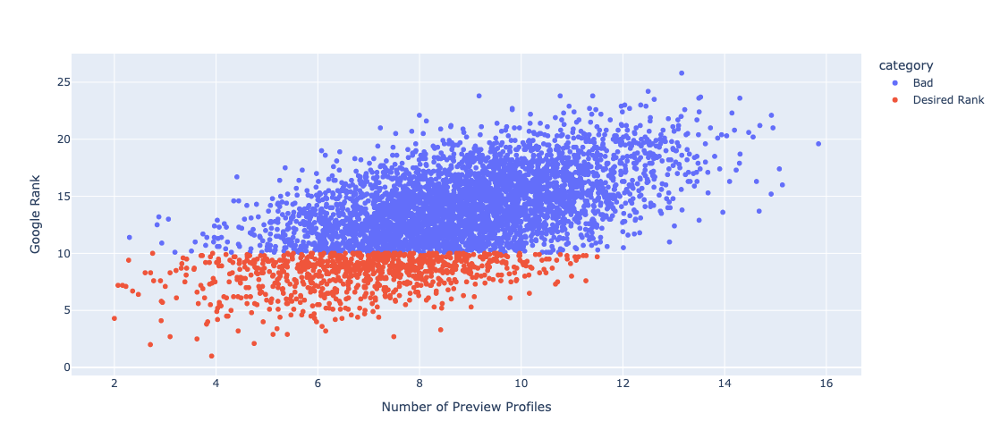

In [12]:
data1=data
fig=px.scatter(data,x='Number of Preview Profiles',y='Google Rank',log_y=False,
              log_x=False,color='category')
fig.update_layout(
    width=900, height=500,


    
    )

In [18]:
data1['Range_PP'] =pd.cut(round(data1['Number of Preview Profiles']), bins=[0,6,8,10,100], labels=['0-6','6-8','8-10','greater than 10'])
data1

,URL,Google Rank,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words,category,Range_PP
0,www.zocdoc.com/REMOVED,13.3,2.925108,8.155650,5.492020,0.411771,0.027854,Bad,6-8
1,www.zocdoc.com/REMOVED,15.4,5.017281,9.216409,6.675830,0.398341,0.299199,Bad,8-10
2,www.zocdoc.com/REMOVED,12.8,3.589217,5.160371,4.845896,0.525228,0.099290,Bad,0-6
3,www.zocdoc.com/REMOVED,8.6,5.026451,7.585764,4.317448,0.312497,0.230270,Desired Rank,6-8
4,www.zocdoc.com/REMOVED,9.4,3.506564,4.271116,6.056736,0.347528,0.029108,Desired Rank,0-6
...,...,...,...,...,...,...,...,...,...
4995,www.zocdoc.com/REMOVED,14.6,3.604645,9.048714,5.494865,0.410219,0.005616,Bad,8-10
4996,www.zocdoc.com/REMOVED,7.9,4.231499,4.478854,4.143249,0.517284,0.048231,Desired Rank,0-6
4997,www.zocdoc.com/REMOVED,14.2,2.651688,10.261650,4.371300,0.436143,0.199530,Bad,8-10
4998,www.zocdoc.com/REMOVED,15.0,3.982989,10.583220,5.191706,0.447086,0.179928,Bad,greater than 10


In [19]:
data1.groupby(['Range_PP','category']).size().reset_index().rename(columns={0:'count'}).\
pivot_table(index='Range_PP',values='count',columns='category').reset_index().\
assign(percentage_desired_group=lambda x :round(x['Desired Rank']/(x['Desired Rank']+x['Bad'])*100),
      percentage_desired_overall_cumulative=lambda x :round(x['Desired Rank'].cumsum()/(x['Desired Rank'].sum())*100)
      
      )
                                                                                    

/var/folders/q5/58k6fwjd49jgkqktkqdcbfsh0000gn/T/ipykernel_37800/1993911851.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/q5/58k6fwjd49jgkqktkqdcbfsh0000gn/T/ipykernel_37800/1993911851.py:2: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



category,Range_PP,Bad,Desired Rank,percentage_desired_group,percentage_desired_overall_cumulative
0,0-6,372.0,360.0,49.0,40.0
1,6-8,1286.0,370.0,22.0,82.0
2,8-10,1615.0,145.0,8.0,98.0
3,greater than 10,835.0,17.0,2.0,100.0


In [20]:
data1.groupby(['Range_PP','category']).size().reset_index().rename(columns={0:'count'})['count'].sum()

/var/folders/q5/58k6fwjd49jgkqktkqdcbfsh0000gn/T/ipykernel_37800/2007565229.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



np.int64(5000)

In [249]:
data.shape

(5000, 9)

In [21]:
import warnings

warnings.filterwarnings("ignore")

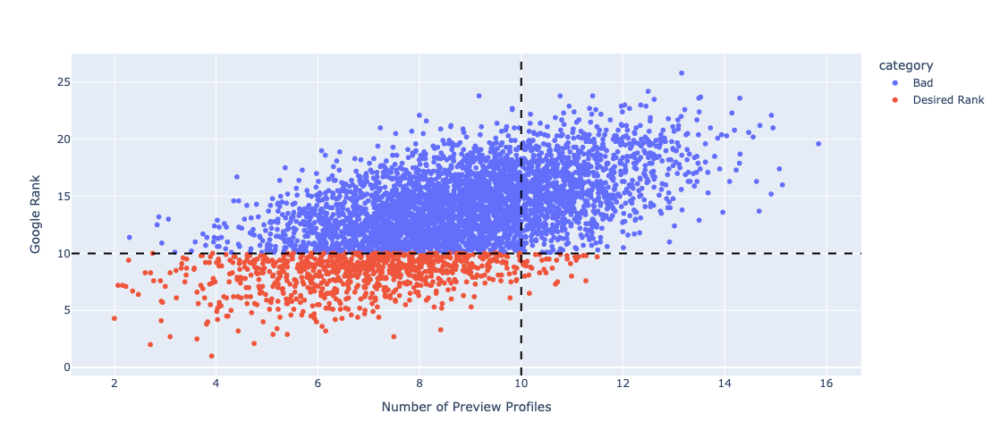

category,Range_PP,Bad,Desired Rank,percentage_desired_group,percentage_desired_overall_cumulative
0,0-6,203.0,268.0,57.0,30.0
1,6-8,1041.0,384.0,27.0,73.0
2,8-10,1699.0,206.0,11.0,96.0
3,greater than 10,1165.0,34.0,3.0,100.0


In [22]:

fig=px.scatter(data,x='Number of Preview Profiles',y='Google Rank',log_y=False,
              log_x=False,color='category')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")
fig.add_hline(y=10, line_width=2, line_dash="dash", line_color="black")
fig.show()
data1['Range_PP'] =pd.cut(data1['Number of Preview Profiles'], bins=[0,6,8,10,100], labels=['0-6','6-8','8-10','greater than 10'])
data1.groupby(['Range_PP','category']).size().reset_index().rename(columns={0:'count'}).\
pivot_table(index='Range_PP',values='count',columns='category').reset_index().\
assign(percentage_desired_group=lambda x :round(x['Desired Rank']/(x['Desired Rank']+x['Bad'])*100),
      percentage_desired_overall_cumulative=lambda x :round(x['Desired Rank'].cumsum()/(x['Desired Rank'].sum())*100)
      
      )

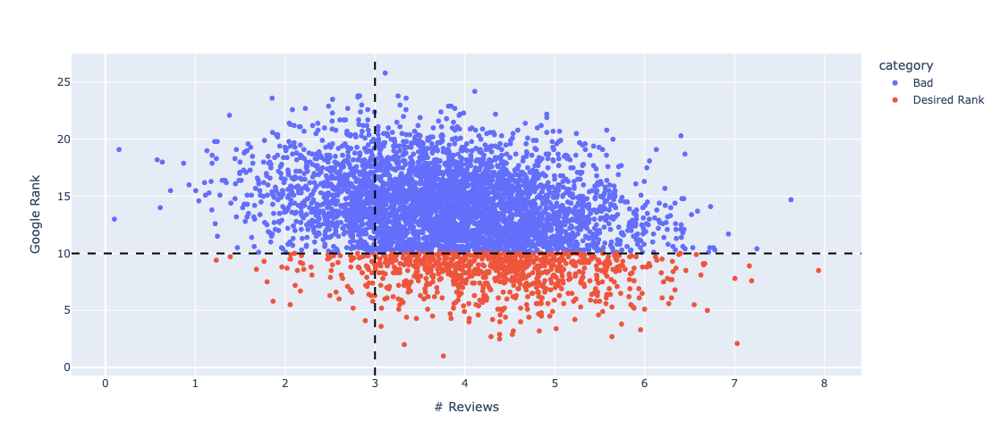

category,Range_Reviews,Bad,Desired Rank,percentage_desired_group,percentage_desired_overall_cumulative
0,0-3,841.0,72.0,8.0,8.0
1,3-6,3210.0,787.0,20.0,96.0
2,greater than 6,57.0,33.0,37.0,100.0


In [77]:

fig=px.scatter(data,x='# Reviews',y='Google Rank',log_y=False,
              log_x=False,color='category')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_vline(x=3, line_width=2, line_dash="dash", line_color="black")
# fig.add_vline(x=3, line_width=2, line_dash="dash", line_color="black")
# fig.add_vline(x=6, line_width=2, line_dash="dash", line_color="black")
fig.add_hline(y=10, line_width=2, line_dash="dash", line_color="black")
fig.show()
data1['Range_Reviews'] =pd.cut(data1['# Reviews'], bins=[0,3,6,100], labels=['0-3','3-6','greater than 6'])
data1.groupby(['Range_Reviews','category']).size().reset_index().rename(columns={0:'count'}).\
pivot_table(index='Range_Reviews',values='count',columns='category').reset_index().\
assign(percentage_desired_group=lambda x :round(x['Desired Rank']/(x['Desired Rank']+x['Bad'])*100),
      percentage_desired_overall_cumulative=lambda x :round(x['Desired Rank'].cumsum()/(x['Desired Rank'].sum())*100)
      
      )

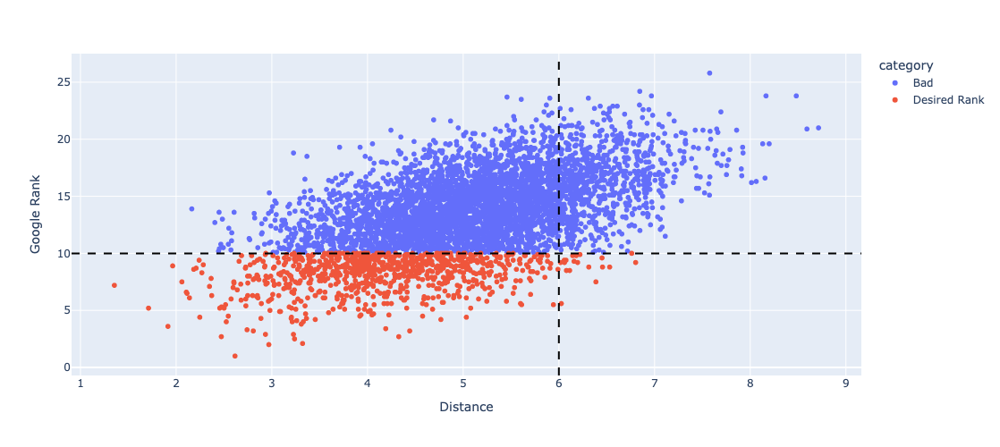

category,Range_Distance,Bad,Desired Rank,percentage_desired_group,percentage_desired_overall_cumulative
0,0-6,3334.0,873.0,21.0,98.0
1,greater than 6,774.0,19.0,2.0,100.0


In [76]:
fig=px.scatter(data,x='Distance',y='Google Rank',log_y=False,
              log_x=False,color='category')
fig.update_layout(
    width=900, height=500,


    
    )

fig.add_vline(x=6, line_width=2, line_dash="dash", line_color="black")

fig.add_hline(y=10, line_width=2, line_dash="dash", line_color="black")
fig.show()
data1['Range_Distance'] =pd.cut(data1['Distance'], bins=[0,6,100], labels=['0-6','greater than 6'])
data1.groupby(['Range_Distance','category']).size().reset_index().rename(columns={0:'count'}).\
pivot_table(index='Range_Distance',values='count',columns='category').reset_index().\
assign(percentage_desired_group=lambda x :round(x['Desired Rank']/(x['Desired Rank']+x['Bad'])*100),
      percentage_desired_overall_cumulative=lambda x :round(x['Desired Rank'].cumsum()/(x['Desired Rank'].sum())*100)
      
      )

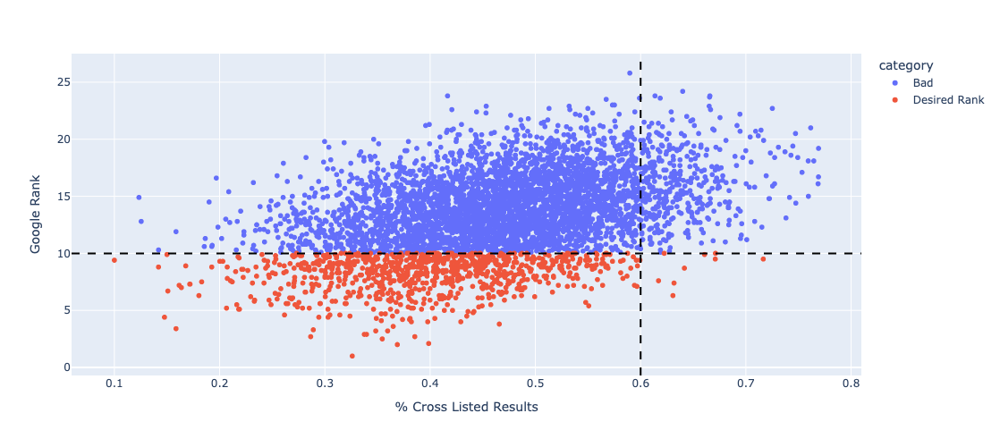

category,Range_Cross,Bad,Desired Rank,percentage_desired_group,percentage_desired_overall_cumulative
0,0-30%,142.0,127.0,47.0,14.0
1,30-60%,3565.0,756.0,17.0,99.0
2,greater than 60%,401.0,9.0,2.0,100.0


In [592]:
fig=px.scatter(data,x='% Cross Listed Results',y='Google Rank',log_y=False,
              log_x=False,color='category')
fig.update_layout(
    width=900, height=500,


    
    )

# fig.add_vline(x=5, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=0.6, line_width=2, line_dash="dash", line_color="black")
fig.add_hline(y=10, line_width=2, line_dash="dash", line_color="black")
fig.show()
data1['Range_Cross'] =pd.cut(data1['% Cross Listed Results'], bins=[0,0.3,0.6,1], labels=['0-30%','30-60%','greater than 60%'])
data1.groupby(['Range_Cross','category']).size().reset_index().rename(columns={0:'count'}).\
pivot_table(index='Range_Cross',values='count',columns='category').reset_index().\
assign(percentage_desired_group=lambda x :round(x['Desired Rank']/(x['Desired Rank']+x['Bad'])*100),
      percentage_desired_overall_cumulative=lambda x :round(x['Desired Rank'].cumsum()/(x['Desired Rank'].sum())*100))
      
      

In [13]:
def condition2(x):
    if x<3:
        return 100
    else :
        return 20
def condition3(x):
    if x>=4:
        return 100
    else :
        return 20
data1['distance_size']=data1['Distance'].apply(condition2)
data1['review_size']=data1['# Reviews'].apply(condition3)

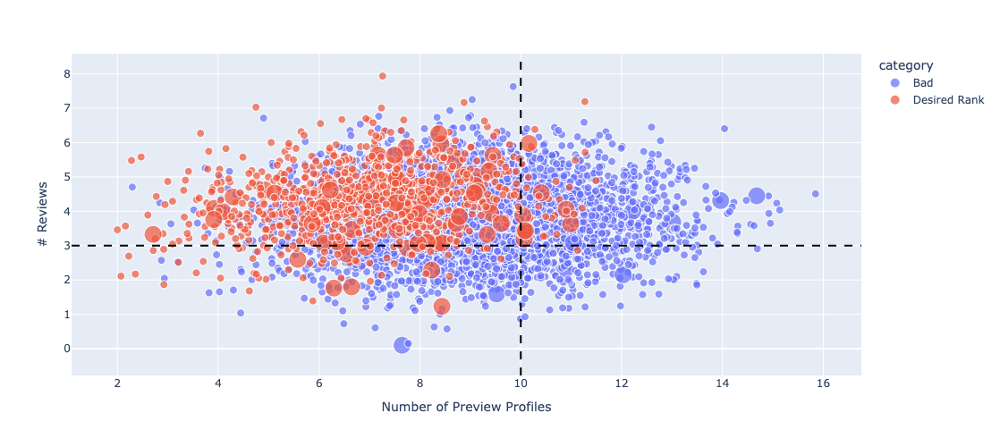

In [14]:

fig=px.scatter(data1,y='# Reviews',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='distance_size')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_hline(y=3, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")

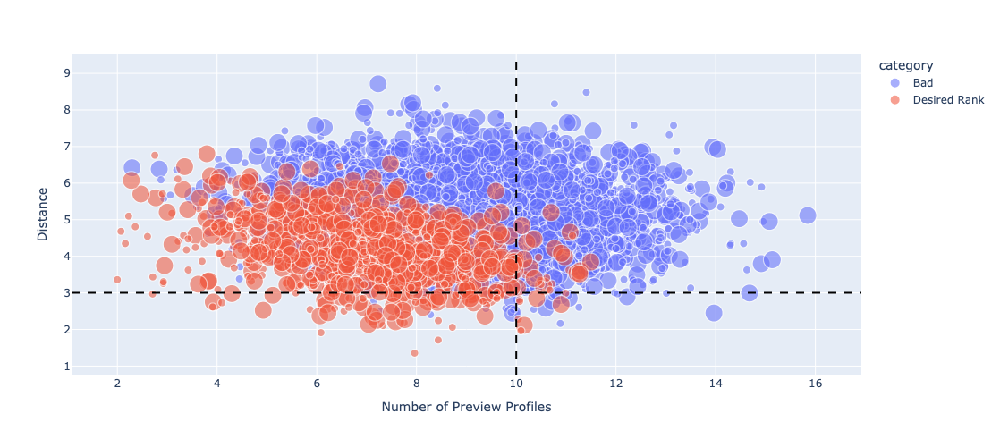

In [37]:

fig=px.scatter(data1,y='Distance',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='review_size')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_hline(y=3, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")
fig.update_traces(opacity=.8)

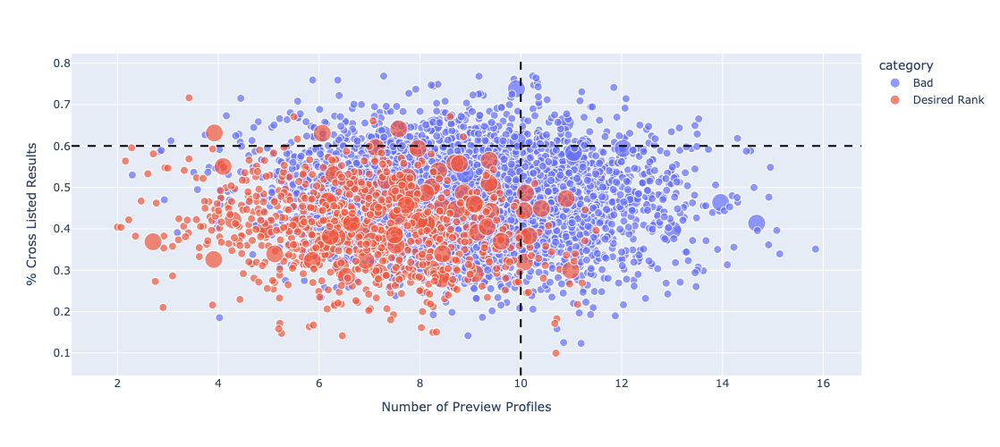

In [40]:
fig=px.scatter(data1,y='% Cross Listed Results',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='distance_size')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_hline(y=0.6, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")

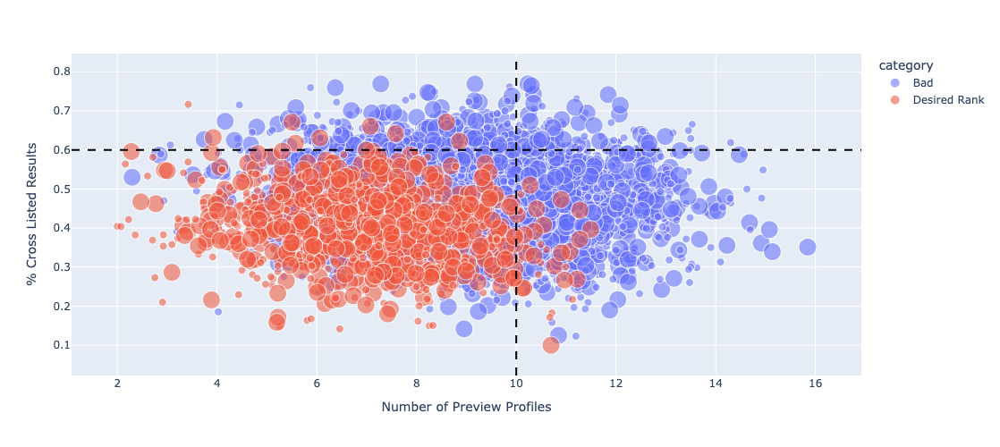

In [39]:
fig=px.scatter(data1,y='% Cross Listed Results',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='review_size')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_hline(y=0.6, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")
fig.update_traces(opacity=.8)

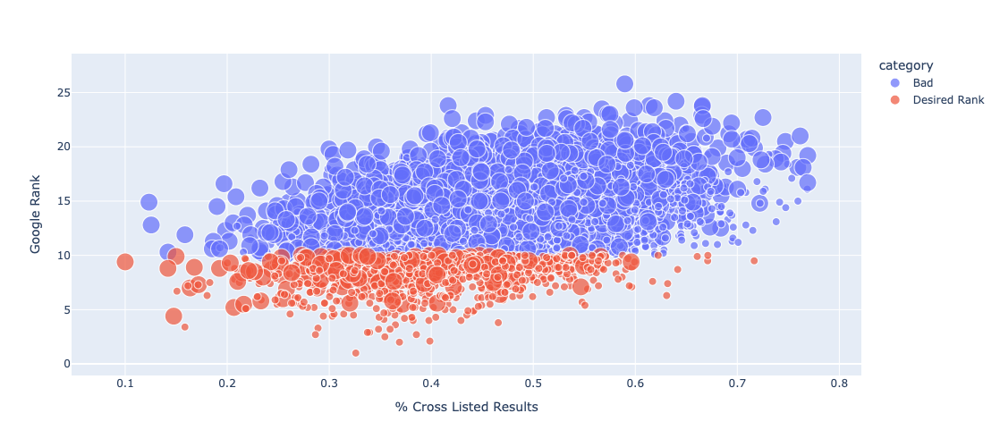

In [576]:
fig=px.scatter(data1,y='Google Rank',x='% Cross Listed Results',log_y=False,
              log_x=False,color='category',size='distance_size')
fig.update_layout(
    width=900, height=500,


    
    )
#fig.add_hline(y=3, line_width=2, line_dash="dash", line_color="black")
#fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")

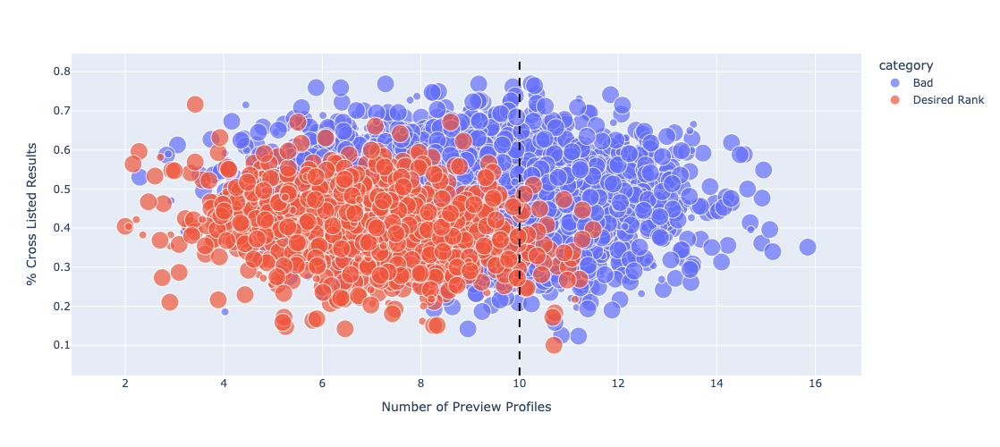

In [442]:
fig=px.scatter(data1,y='% Cross Listed Results',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='review_size')
fig.update_layout(
    width=900, height=500,


    
    )
#fig.add_hline(y=3, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")

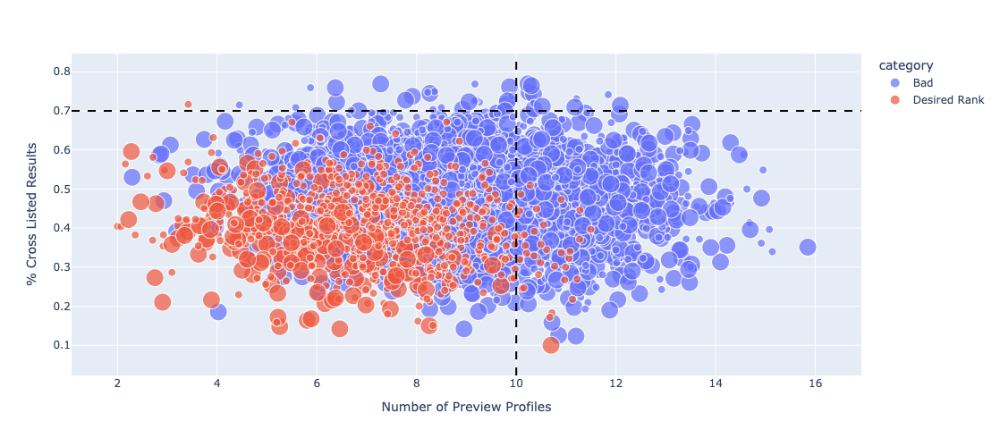

In [587]:
fig=px.scatter(data1,y='% Cross Listed Results',x='Number of Preview Profiles',log_y=False,
              log_x=False,color='category',size='distance_size')
fig.update_layout(
    width=900, height=500,


    
    )
fig.add_hline(y=0.7, line_width=2, line_dash="dash", line_color="black")
fig.add_vline(x=10, line_width=2, line_dash="dash", line_color="black")

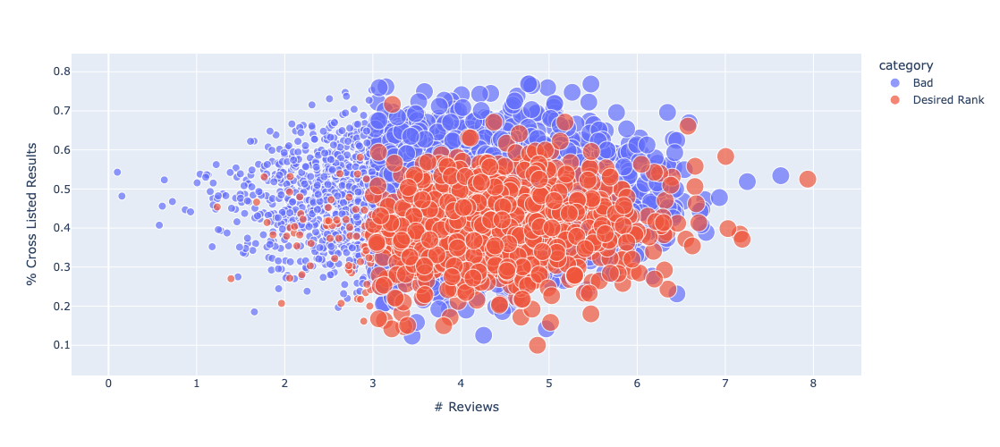

In [444]:
fig=px.scatter(data1,y='% Cross Listed Results',x='# Reviews',log_y=False,
              log_x=False,color='category',size='review_size')
fig.update_layout(
    width=900, height=500,


    
    )

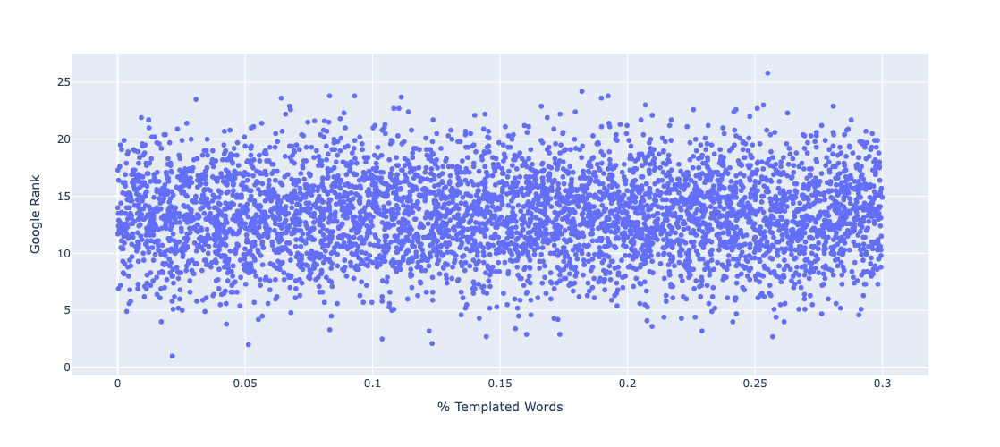

In [18]:
fig=px.scatter(data,x='% Templated Words',y='Google Rank',log_y=False,
              log_x=False)
fig.update_layout(
    width=900, height=500,


    
    )

In [26]:
all_data

,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words,category,distance_size,review_size
0,2.925108,8.155650,5.492020,0.411771,0.027854,Bad,20,20
1,5.017281,9.216409,6.675830,0.398341,0.299199,Bad,20,100
2,3.589217,5.160371,4.845896,0.525228,0.099290,Bad,20,20
3,5.026451,7.585764,4.317448,0.312497,0.230270,Desired Rank,20,100
4,3.506564,4.271116,6.056736,0.347528,0.029108,Desired Rank,20,20
...,...,...,...,...,...,...,...,...
4995,3.604645,9.048714,5.494865,0.410219,0.005616,Bad,20,20
4996,4.231499,4.478854,4.143249,0.517284,0.048231,Desired Rank,20,100
4997,2.651688,10.261650,4.371300,0.436143,0.199530,Bad,20,20
4998,3.982989,10.583220,5.191706,0.447086,0.179928,Bad,20,20


In [27]:
from sklearn.linear_model import LinearRegression
labels=data['Google Rank']

all_data=data.drop(columns=["Google Rank",'URL','category','distance_size','review_size'])
numeric_features =  all_data.select_dtypes(include=["float"]).columns

categorical_features=all_data.select_dtypes(exclude=["float","bool"]).columns
bool_features=all_data.select_dtypes(include=["bool"]).columns
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])


categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)],remainder="passthrough")

# Append classifier to preprocessing pipeline.
# Now we have a full prediction pipeline.
clf = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', LinearRegression())])

X_train, X_test, y_train, y_test = train_test_split(all_data, labels, test_size=0.2,random_state=42)

clf.fit(X_train, y_train)
print("model score: %.3f" % clf.score(X_test, y_test))

model score: 0.918


In [28]:
preprocessor_tree = ColumnTransformer(
    transformers=[
        
        ('cat', categorical_transformer, categorical_features)],remainder="passthrough")
data_pipeline=Pipeline(steps=[('preprocessor_tree', preprocessor_tree)])
data_pipeline.fit(all_data)
data_trans=data_pipeline.fit_transform(all_data)
Xtrain, Xtest, ytrain, ytest = train_test_split(data_trans, labels, test_size=0.2,random_state=42)

In [29]:
from sklearn.linear_model import LinearRegression
numeric_features =  all_data.select_dtypes(include=["float"]).columns
categorical_features=all_data.select_dtypes(exclude=["float","bool"]).columns
bool_features=all_data.select_dtypes(include=["bool"]).columns
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])


categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)],remainder="passthrough")

# Append classifier to preprocessing pipeline.
# Now we have a full prediction pipeline.
clf = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', LinearRegression())])

X_train, X_test, y_train, y_test = train_test_split(all_data, labels, test_size=0.2,random_state=42)

clf.fit(X_train, y_train)
print("model score: %.3f" % clf.score(X_test, y_test))

model score: 0.918


In [30]:
from sklearn.compose import ColumnTransformer
from sklearn.datasets import fetch_openml
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder,MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LassoLars
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble  import  AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import metrics
from xgboost import XGBRegressor
from sklearn.model_selection import cross_val_score
# from keras.models import Sequential
# from keras.layers import Dense
# from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import cross_val_predict
import matplotlib.pyplot as plt
from yellowbrick.regressor import ResidualsPlot

In [19]:
# all_data1=all_data.drop(columns={'# Reviews','Distance','% Cross Listed Results'})

In [33]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_data = pd.DataFrame()
vif_data["feature"] = all_data.columns

# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(all_data.values, i)
                          for i in range(len(all_data.columns))]

print(vif_data)

                      feature        VIF
0                   # Reviews  13.297463
1  Number of Preview Profiles  15.283740
2                    Distance  18.460072
3      % Cross Listed Results  16.570027
4           % Templated Words   3.976182


In [34]:
import seaborn as sns
import matplotlib.pyplot as plt
corr = all_data.select_dtypes(include=(float,int)).corr()

# Create the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()

/var/folders/q5/58k6fwjd49jgkqktkqdcbfsh0000gn/T/ipykernel_41368/946196131.py:8: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



In [36]:
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Print the coefficients
print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)


Coefficients: [-0.99372109  0.9993271   1.99427287 14.85576939  0.04743785]
Intercept: -8.296741805439478


In [452]:
data2[['GoogleRank','Reviews','NumberofPreviewProfiles','Distance','CrossListedResults','TemplatedWords']]

,GoogleRank,Reviews,NumberofPreviewProfiles,Distance,CrossListedResults,TemplatedWords
0,13.3,2.925108,8.155650,5.492020,0.411771,0.027854
1,15.4,5.017281,9.216409,6.675830,0.398341,0.299199
2,12.8,3.589217,5.160371,4.845896,0.525228,0.099290
3,8.6,5.026451,7.585764,4.317448,0.312497,0.230270
4,9.4,3.506564,4.271116,6.056736,0.347528,0.029108
...,...,...,...,...,...,...
4995,14.6,3.604645,9.048714,5.494865,0.410219,0.005616
4996,7.9,4.231499,4.478854,4.143249,0.517284,0.048231
4997,14.2,2.651688,10.261650,4.371300,0.436143,0.199530
4998,15.0,3.982989,10.583220,5.191706,0.447086,0.179928


In [37]:
from sklearn.metrics import r2_score, mean_squared_error, make_scorer
from sklearn.model_selection import train_test_split


regressors = [
    (LinearRegression(),"linear regression "),
    (Lasso(alpha=.5),"Lasso"),
    (Ridge(alpha=.1),"Ridge"),
    
    (DecisionTreeRegressor(),"Decision Trees"),
    (RandomForestRegressor(),"Random Fores"),
    (AdaBoostRegressor(),"Ada-Boost"),
    (GradientBoostingRegressor(),"GBM"),
    (XGBRegressor(),"xgboost")
    
    
]


def MSE(y_true,y_pred):
    mse = mean_squared_error(y_true, y_pred)
    print ('MSE: %2.3f' % mse)
    return mse




def R2(y_true,y_pred):    
     r2 = r2_score(y_true, y_pred)
     print ('R2: %2.3f' % r2)
     return r2

def two_score(y_true,y_pred):    
    MSE(y_true,y_pred) #set score here and not below if using MSE in GridCV
    score = R2(y_true,y_pred)
    return score

def two_scorer():
    return make_scorer(two_score, greater_is_better=True)

for r,v in regressors :
    
    clf = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', r)])
    clf.fit(X_train, y_train)
    scores = cross_val_score(clf,X_train, y_train, cv=5,scoring=two_scorer())
    
    print("Model R^2:"+ " " + str(v)+" "+"%0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))
    

MSE: 1.019
R2: 0.918
MSE: 1.032
R2: 0.921
MSE: 0.999
R2: 0.916
MSE: 1.112
R2: 0.904
MSE: 1.030
R2: 0.919
Model R^2: linear regression  0.92 (+/- 0.01)
MSE: 2.089
R2: 0.831
MSE: 2.054
R2: 0.842
MSE: 1.962
R2: 0.835
MSE: 1.990
R2: 0.828
MSE: 2.075
R2: 0.837
Model R^2: Lasso 0.83 (+/- 0.01)
MSE: 1.019
R2: 0.918
MSE: 1.032
R2: 0.921
MSE: 0.999
R2: 0.916
MSE: 1.112
R2: 0.904
MSE: 1.030
R2: 0.919
Model R^2: Ridge 0.92 (+/- 0.01)
MSE: 3.265
R2: 0.736
MSE: 2.856
R2: 0.781
MSE: 2.976
R2: 0.750
MSE: 3.425
R2: 0.704
MSE: 3.119
R2: 0.754
Model R^2: Decision Trees 0.75 (+/- 0.05)
MSE: 1.509
R2: 0.878
MSE: 1.374
R2: 0.894
MSE: 1.350
R2: 0.886
MSE: 1.520
R2: 0.869
MSE: 1.375
R2: 0.892
Model R^2: Random Fores 0.88 (+/- 0.02)
MSE: 2.303
R2: 0.814
MSE: 2.075
R2: 0.841
MSE: 2.077
R2: 0.825
MSE: 2.309
R2: 0.801
MSE: 2.092
R2: 0.835
Model R^2: Ada-Boost 0.82 (+/- 0.03)
MSE: 1.204
R2: 0.903
MSE: 1.163
R2: 0.911
MSE: 1.151
R2: 0.903
MSE: 1.283
R2: 0.889
MSE: 1.156
R2: 0.909
Model R^2: GBM 0.90 (+/- 0.02)
MSE

In [38]:
rf = RandomForestRegressor(n_estimators=100)
rf.fit(X_train,y_train)

RandomForestRegressor()

In [39]:
two_score(y_test,rf.predict(X_test))

MSE: 1.428
R2: 0.880


0.8799604054028334

In [44]:
from yellowbrick.regressor import ResidualsPlot
import matplotlib
matplotlib.use('Agg')
#best_clf_ridge = searchCV.best_estimator_.named_steps['rdg']


visualizer1=ResidualsPlot(rf)
visualizer1.fit(X_train, y_train) # Fit the training data to the visualizer

visualizer1.score(X_test, y_test)  # Evaluate the model on the test data
visualizer1.show() 

/var/folders/q5/58k6fwjd49jgkqktkqdcbfsh0000gn/T/ipykernel_41368/2513842481.py:3: MatplotlibDeprecationWarning:

Auto-close()ing of figures upon backend switching is deprecated since 3.8 and will be removed in 3.10.  To suppress this warning, explicitly call plt.close('all') first.

/Users/shrutibiradar/Desktop/zocdoc/zocdoc/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names

/Users/shrutibiradar/Desktop/zocdoc/zocdoc/lib/python3.12/site-packages/yellowbrick/base.py:246: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



<Axes: title={'center': 'Residuals for RandomForestRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [516]:
data2

,Google Rank,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words,category,Range_PP,Range_Reviews,Range_Distance,Range_Cross,distance_size,review_size
0,13.3,2.925108,8.155650,5.492020,0.411771,0.027854,Bad,6-8,0-3,0-5,30-60%,100,20
1,15.4,5.017281,9.216409,6.675830,0.398341,0.299199,Bad,8-10,3-6,5-7,30-60%,100,100
2,12.8,3.589217,5.160371,4.845896,0.525228,0.099290,Bad,0-6,3-6,0-5,30-60%,20,100
3,8.6,5.026451,7.585764,4.317448,0.312497,0.230270,Desired Rank,6-8,3-6,0-5,30-60%,20,100
4,9.4,3.506564,4.271116,6.056736,0.347528,0.029108,Desired Rank,0-6,3-6,5-7,30-60%,100,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,14.6,3.604645,9.048714,5.494865,0.410219,0.005616,Bad,8-10,3-6,0-5,30-60%,100,100
4996,7.9,4.231499,4.478854,4.143249,0.517284,0.048231,Desired Rank,0-6,3-6,0-5,30-60%,20,100
4997,14.2,2.651688,10.261650,4.371300,0.436143,0.199530,Bad,8-10,0-3,0-5,30-60%,20,20
4998,15.0,3.982989,10.583220,5.191706,0.447086,0.179928,Bad,greater than 10,3-6,0-5,30-60%,100,100


In [47]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
data2=data.drop(columns={'URL'})
data2.columns = data2.columns.str.replace('[^a-zA-Z0-9]', '', regex=True)
data3=data2

data3['NumberofPreviewProfiles']=data3['NumberofPreviewProfiles']-10
rdd_df = data3.assign(threshold=(data3["NumberofPreviewProfiles"] > 0).astype(int))
model_1 = smf.ols(formula='GoogleRank ~ Distance+CrossListedResults+Reviews+TemplatedWords+threshold', data=rdd_df).fit()
model_1.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             GoogleRank   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.762
Method:                 Least Squares   F-statistic:                     3201.
Date:                Tue, 19 Nov 2024   Prob (F-statistic):               0.00
Time:                        22:44:37   Log-Likelihood:                -9765.7
No. Observations:                5000   AIC:                         1.954e+04
Df Residuals:                    4994   BIC:                         1.958e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -0.7790      0.197     -3.946      0.000      -1.166      -0.392
Distance               2.0226      0.024     83.365      0.000       1.975       2.070
CrossListedResults    15.0354      0.241     62.337      0.000      14.563      15.508
Reviews               -0.9952      0.024    -41.259      0.000      -1.042      -0.948
TemplatedWords         0.3966      0.281      1.409      0.159      -0.155       0.948
threshold              3.3968      0.057     60.055      0.000       3.286       3.508
==============================================================================
Omnibus:                       66.606   Durbin-Watson:                   1.959
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               68.955
Skew:                          -0.285   Prob(JB):                     1.06e-15
Kurtosis:                       3.084   Cond. No.                         79.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [46]:
model_1.params

Intercept             -0.771756
Distance               2.022605
CrossListedResults    15.035114
Reviews               -0.996937
TemplatedWords         0.396381
threshold              3.367128
threshold:Reviews      0.007651
dtype: float64

In [49]:
import shap
import interpret.glassbox

model_ebm = interpret.glassbox.ExplainableBoostingRegressor(interactions=0)
model_ebm.fit(X_train, y_train)

# explain the GAM model with SHAP
explainer_ebm = shap.Explainer(model_ebm.predict, X_test)
shap_values_ebm = explainer_ebm(X_test)


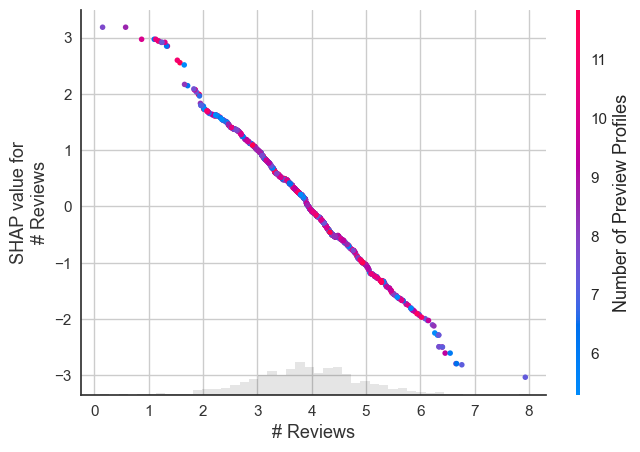

In [434]:
shap.plots.scatter(shap_values_ebm[:, "# Reviews"],color=shap_values_ebm)

In [50]:
shap.plots.scatter(shap_values_ebm[:, "% Cross Listed Results"],color=shap_values_ebm)

/Users/shrutibiradar/Desktop/zocdoc/zocdoc/lib/python3.12/site-packages/shap/plots/_scatter.py:470: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



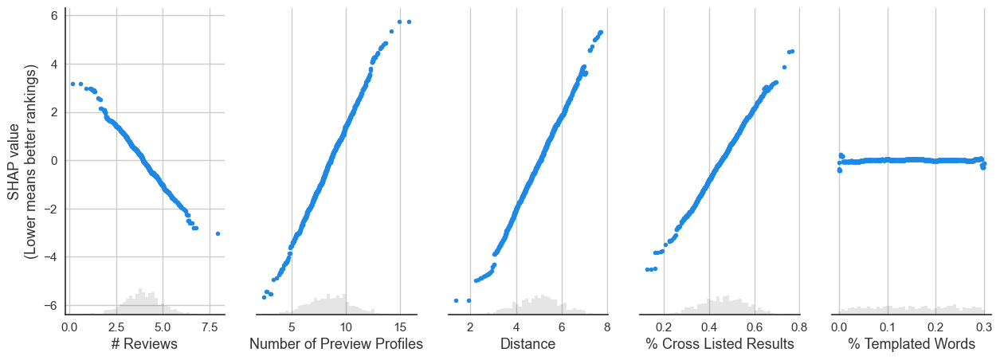

In [595]:
shap.plots.scatter(shap_values_ebm, ylabel="SHAP value\n(Lower means better rankings)")

In [173]:
import shap
shap.initjs()
explainer = shap.TreeExplainer(rf, X_test)


In [174]:
X_test=X_test.reset_index(drop=True)
predicted_y=rf.predict(X_test)


In [175]:
import numpy as np
print("index max rating"+ str(np.where(predicted_y==np.amax(predicted_y))))
print("index min rating" + str(np.where(predicted_y==np.amin(predicted_y))))
print("index median rating" + str(np.where(predicted_y==np.median(predicted_y))))

index max rating(array([570]),)
index min rating(array([154]),)
index median rating(array([], dtype=int64),)


In [56]:
X_test.loc[[223]]

,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words
223,4.47093,8.346716,3.27051,0.56157,0.202873


In [47]:
X_test

,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words
0,3.332322,7.455957,4.756963,0.327942,0.138300
1,4.856425,7.099646,3.609591,0.694948,0.083060
2,5.559948,8.464459,4.528327,0.424247,0.177776
3,3.815454,8.499718,6.114313,0.548333,0.272632
4,4.940366,12.186461,4.883762,0.472189,0.116901
...,...,...,...,...,...
995,5.291388,6.871542,6.205976,0.422580,0.043982
996,4.431270,8.355440,6.377506,0.485584,0.208198
997,4.417987,6.078186,5.369724,0.542623,0.172384
998,5.180559,12.051308,4.325423,0.435721,0.044655


In [176]:
y_test=y_test.reset_index(drop=True)

In [177]:
print("actual_rating= "+str(y_test[33]),"predicted_rating= "+str(predicted_y[1]))

choosen_instance=X_test.loc[[33]]
shap_values = explainer.shap_values(choosen_instance)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, choosen_instance,feature_names=all_data.columns)

actual_rating= 9.5 predicted_rating= 11.130000000000003


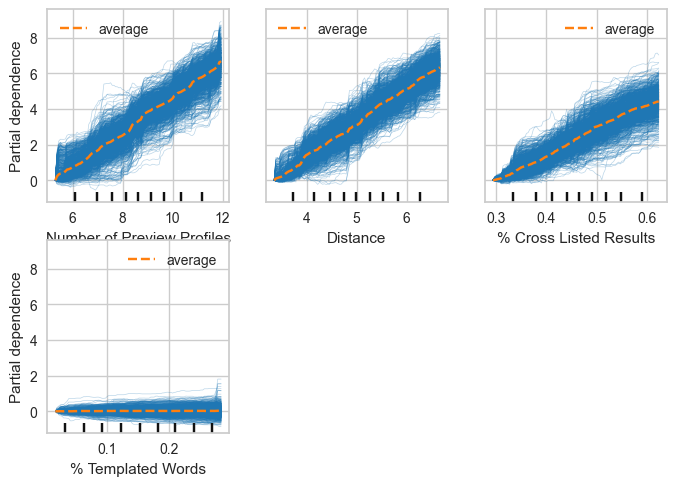

In [181]:
disp1 = PartialDependenceDisplay.from_estimator(rf, X_train,
                                                [1, 2,3,4], kind='both', centered=True)

In [179]:
import matplotlib
#matplotlib.use('Qt5Agg')
shap_values = explainer.shap_values(X_test)

 99%|===================| 987/1000 [00:57<00:00]        

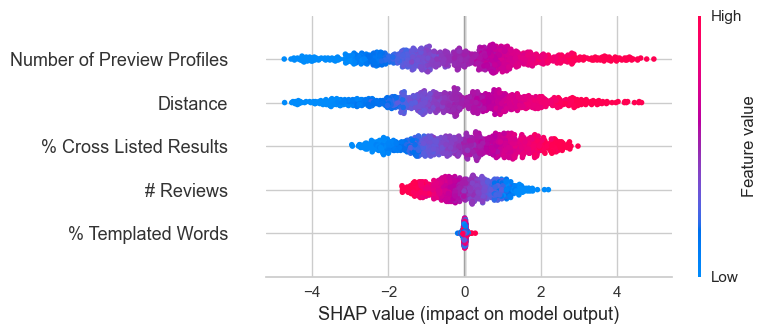

In [180]:
shap.summary_plot(shap_values, X_test,feature_names=all_data.columns)

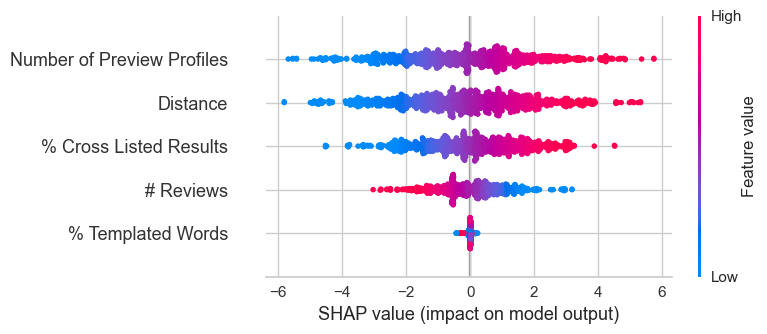

In [596]:
shap.summary_plot(shap_values_ebm, X_test,feature_names=all_data.columns)

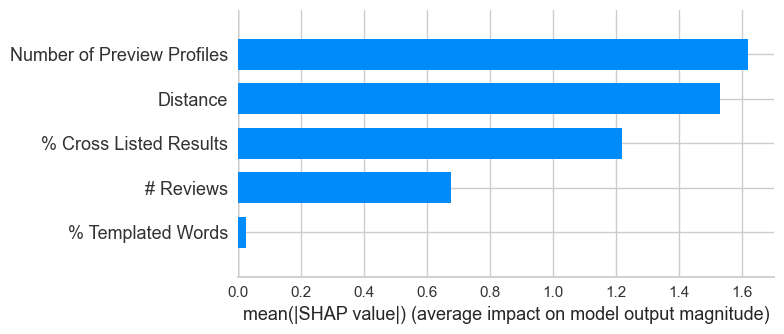

In [66]:
shap.summary_plot(shap_values, X_test, plot_type="bar",feature_names=all_data.columns)

In [86]:
shap_interaction = explainer.shap_interaction_values(X_train)

AttributeError: 'ExactExplainer' object has no attribute 'shap_interaction_values'

In [69]:
print(np.shape(shap_interaction))

# SHAP interaction values for first employee
pd.DataFrame(shap_interaction[0],index=X_train.columns,columns=X_train.columns)

(4000, 5, 5)


,# Reviews,Number of Preview Profiles,Distance,% Cross Listed Results,% Templated Words
# Reviews,-1.193599,-0.074298,0.002003,-0.050434,-0.008423
Number of Preview Profiles,-0.074298,-0.868821,-0.057807,-0.129323,-0.011385
Distance,0.002003,-0.057807,-1.528141,-0.091077,-0.023717
% Cross Listed Results,-0.050434,-0.129323,-0.091077,1.120686,-0.002592
% Templated Words,-0.008423,-0.011385,-0.023717,-0.002592,0.032323


In [51]:
shap.plots.scatter(shap_values[:, "Number of Preview Profiles"])

NameError: name 'shap_values' is not defined

In [78]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()